In [1]:
import numpy as np
from PIL import Image
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

### Конвертация изображения в матрицы R, G, B и запись их в файл

In [2]:
img = Image.open('fall.jpg')
rgbimg = img.convert('RGB')

In [3]:
r, c, _ = np.array(rgbimg).shape
r, c

(340, 510)

In [ ]:
def create_rgb_arr(rgbimg, rows, cols):
    return np.transpose(np.array(rgbimg).reshape(-1, 3)).reshape(-1, rows, cols)

In [ ]:
rgb_arr = create_rgb_arr(rgbimg, r, c)

In [ ]:
rgb_arr.shape

In [ ]:
import sys

f2 = open('case_tiff.txt','w+').close()
f2 = open('case_tiff.txt','w')
np.set_printoptions(threshold=sys.maxsize)

f2.write(str(r) + '\n')
f2.write(str(c) + '\n')

for i in range(3):
    tmp = rgb_arr[i]
    f2.write(np.array2string(tmp).replace('[', ' ').replace(']', ' '))
    f2.write('\n')
f2.close()

# Считывание из выходного файла итоговых матриц и преобразование их в изображение

In [4]:
def blurry(nametxt, r, c):
    test_arr2 = np.array(open(nametxt, 'r').read().split('R'))
    test_arr2 = test_arr2[1:]
    
    plt.figure(figsize=(20, 15))
    cnt = 0
    sigmas = np.arange(0.5, 10, 0.5)
    for sig_ind in np.arange(0, 4):
        splitting = test_arr2[sig_ind].split('SIGMA')[:-1][0].replace('\n', ' ').split('G')
        R = splitting[0]
        splitting = splitting[1].split('B')
        G = splitting[0]
        B = splitting[1]

        R = np.asarray(R.replace('  ', ' ')[1:-2].split(' '), dtype=float)
        G = np.asarray(G.replace('  ', ' ')[1:-2].split(' '), dtype=float)
        B = np.asarray(B.replace('  ', ' ')[1:-2].split(' '), dtype=float)

        A = []
        A.append(R)
        A.append(G)
        A.append(B)
        A = np.array(A, dtype=np.uint8)

        A = np.transpose(A.reshape(3, -1)).reshape(r, c, 3)

        img = Image.fromarray(A, 'RGB')
        img.resize([r*5,c*5])
        # img.save('final.png')

        cnt += 1
        plt.subplot(2, 2, cnt)
        plt.imshow(img)
        plt.title('$\sigma$ = %f' % sigmas[sig_ind])
    plt.show()

In [5]:
def testing(nameimg, outputxt):
    img = Image.open(nameimg)
    rgbimg = img.convert('RGB')
    r, c, _ = np.array(rgbimg).shape
    blurry(outputxt, r, c)
    return rgbimg

## Тест 1 (Среднее изображение)

(a). Для свертки размера 3 * 3, $\sigma \in [0.5, 5]$ и blocksize (16, 16)

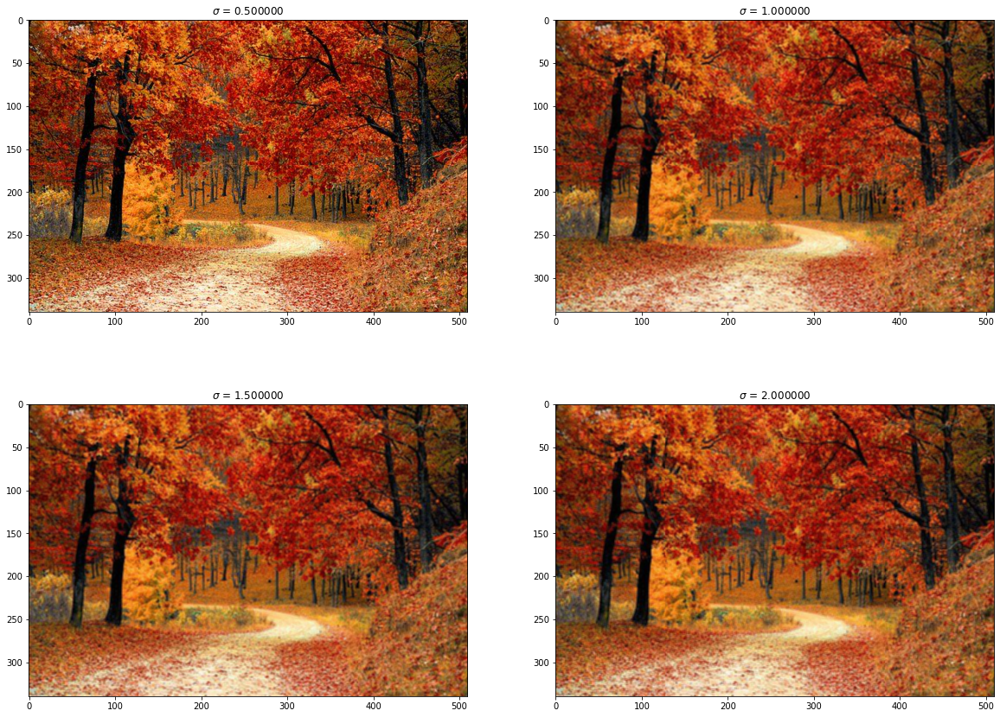

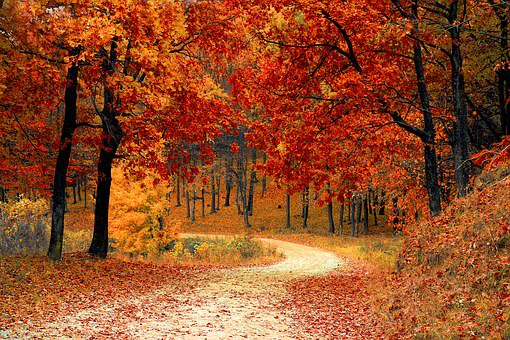

In [6]:
testing('fall.jpg', 'fall_out.txt')

GPU: Elapsed time 0.02 ms

CPU: Elapsed time 0.02 ms

Как видно, свертка работает, но все таки при разных сигма и одинаковых размерах фильтра, они почти неотличимы. Попробуем менять размер окна свертки.

(б). Окно свертки (15, 15), $\sigma = 1$, для лучшего сравнения времени работы blocksize тот же.

In [7]:
def big_img(name):
    test_arr2 = np.array(open(name, 'r').read().replace('\n', ' ').split('R'))
    test_arr2 = test_arr2[1:]
    splitting = test_arr2[0].split('G')
    R = splitting[0]
    splitting = splitting[1].split('B')
    G = splitting[0]
    B = splitting[1]
    R = np.asarray(R.replace('  ', ' ')[1:-2].split(' '), dtype=float)
    G = np.asarray(G.replace('  ', ' ')[1:-2].split(' '), dtype=float)
    B = np.asarray(B.replace('  ', ' ')[1:-2].split(' '), dtype=float)
    
    A = []
    A.append(R)
    A.append(G)
    A.append(B)
    A = np.array(A, dtype=np.uint8)

    A = np.transpose(A.reshape(3, -1)).reshape(r, c, 3)
    
    img = Image.fromarray(A, 'RGB')
    #img.save('show_tree.jpg')
    #img.show()

    plt.figure(figsize=(30, 25))
    plt.imshow(img)
    plt.show()
    
    return rgbimg

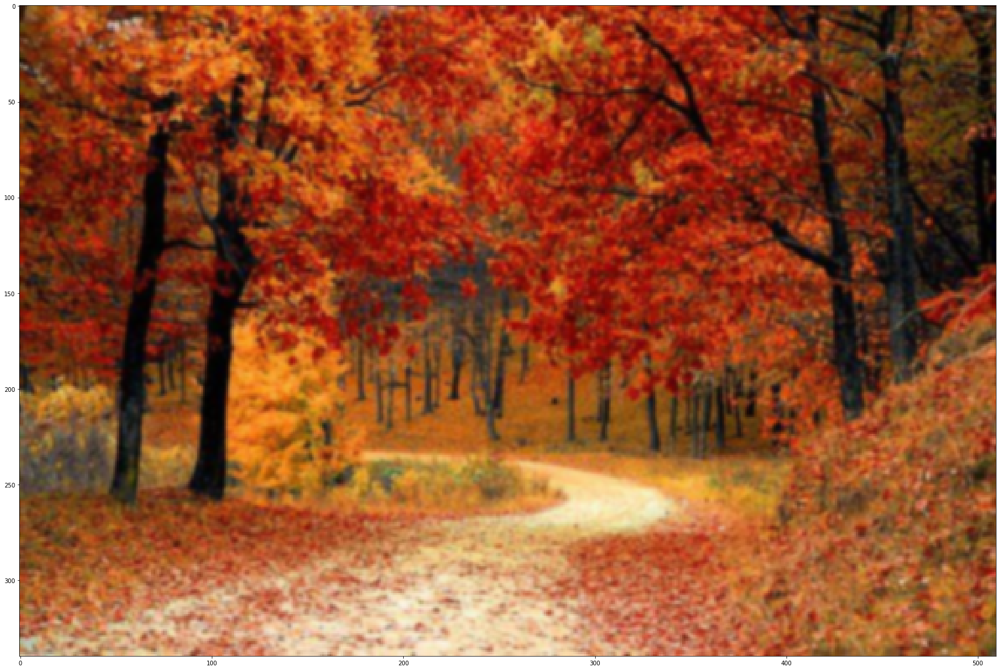

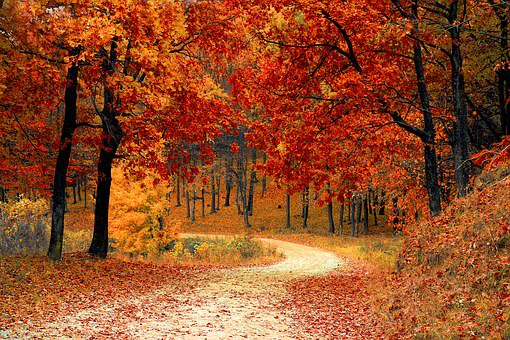

In [8]:
big_img('fall_15_1.txt')

Тоже особо ничего не изменилось.

(с). Теперь попробуем изменить и окно фильтра и сигму.

Пусть окно(15, 15) и сигма = 4

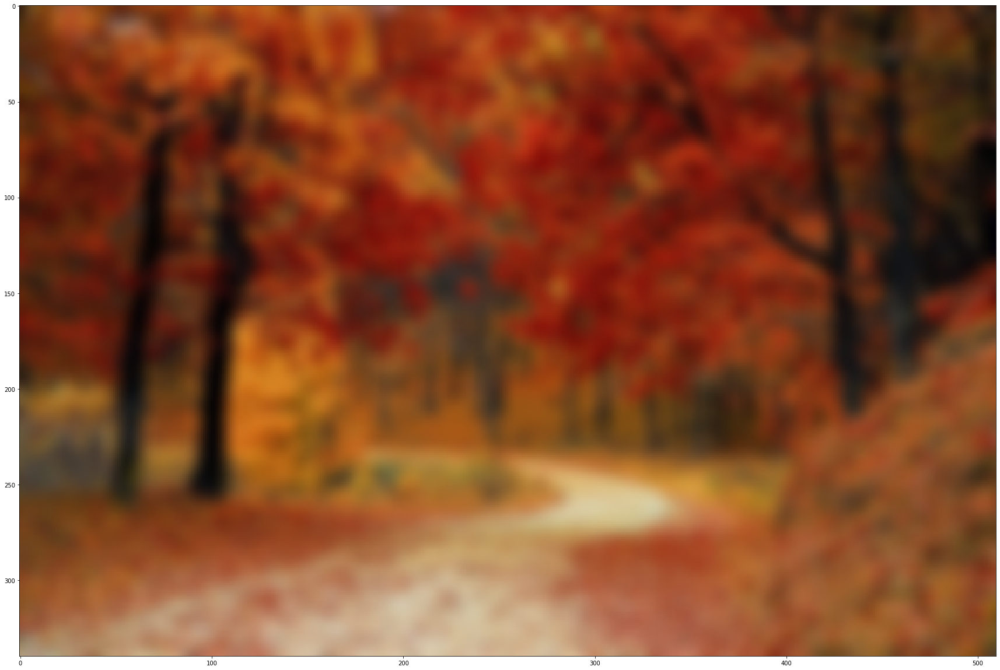

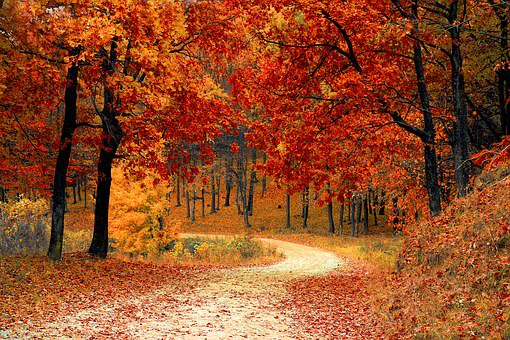

In [9]:
big_img('fall_15_4.txt')

Результат налицо. Действительно, чем больше свертка и сигма, тем больше размытие.

    (15, 15) sigma = 1, block = (16, 16)
    GPU : Elapsed time 4.87 ms
    CPU : Elapsed time 156.81 ms

    (15, 15) sigma = 4, block = (16, 16)
    GPU : Elapsed time 4.93 ms
    CPU : Elapsed time 158.63 ms

## Тест 0

изображение слишком маленькое, но можно заметить, что размытие есть

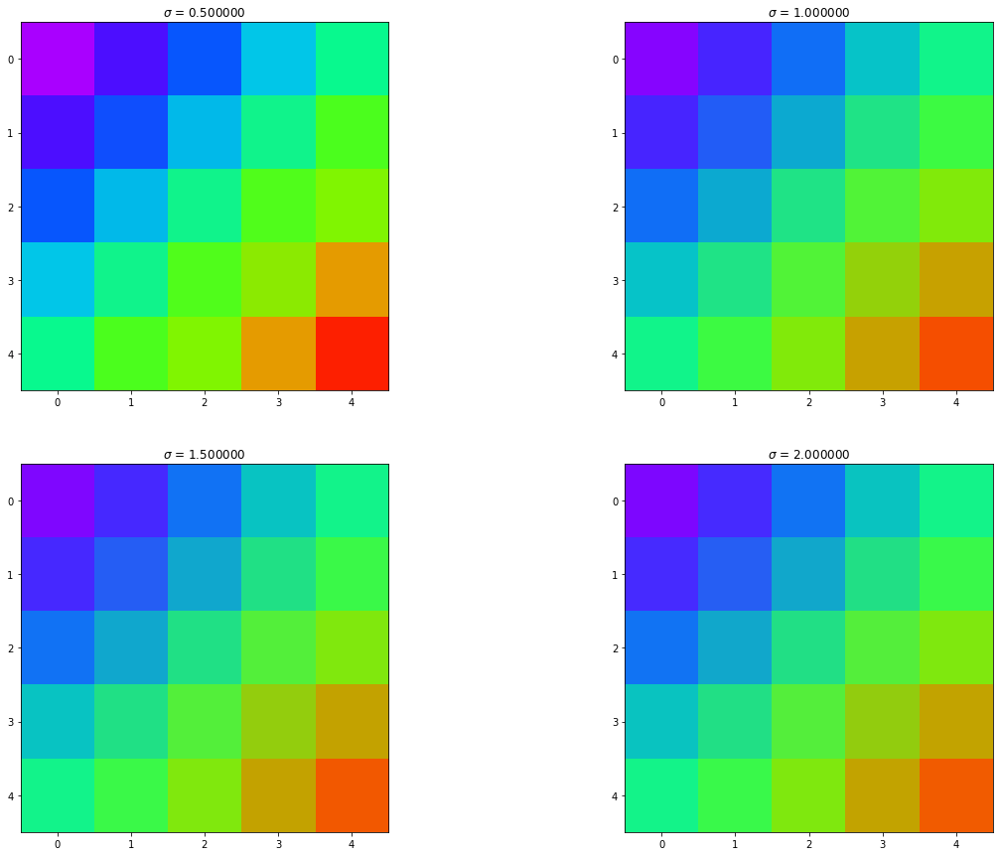

In [10]:
testing('test.tiff', 'stdout_mini.txt')

GPU : Elapsed time 0.11 ms
block(16, 16)
filter(3, 3)

CPU: same

In [ ]:
test_arr2 = np.array(open('stdout_mini.txt', 'r').read().split('R'))
test_arr2 = test_arr2[1:]
    
plt.figure(figsize=(20, 15))

cnt = 0
sig_ind = 1
splitting = test_arr2[sig_ind].split('SIGMA')[:-1][0].replace('\n', ' ').split('G')
R = splitting[0]
splitting = splitting[1].split('B')
G = splitting[0]
B = splitting[1]

R = np.asarray(R.replace('  ', ' ')[1:-2].split(' '), dtype=float)
G = np.asarray(G.replace('  ', ' ')[1:-2].split(' '), dtype=float)
B = np.asarray(B.replace('  ', ' ')[1:-2].split(' '), dtype=float)

A = []
A.append(R)
A.append(G)
A.append(B)
A = np.array(A, dtype=np.uint8)

r, c = 5, 5
A = np.transpose(A.reshape(3, -1)).reshape(r, c, 3)

img = Image.fromarray(A, 'RGB')
img.resize([r*5,c*5])
img.save('show_test.jpg')
img.show()

## Тест 2 (Маленький)

(a). Аналогично Тесту 1. Взяли свертку 3 * 3, blocksize 16 * 16 и посчитали для разных сигм. Результат для всех сигм >= 1 среди предложенных сигм почти идентичный.

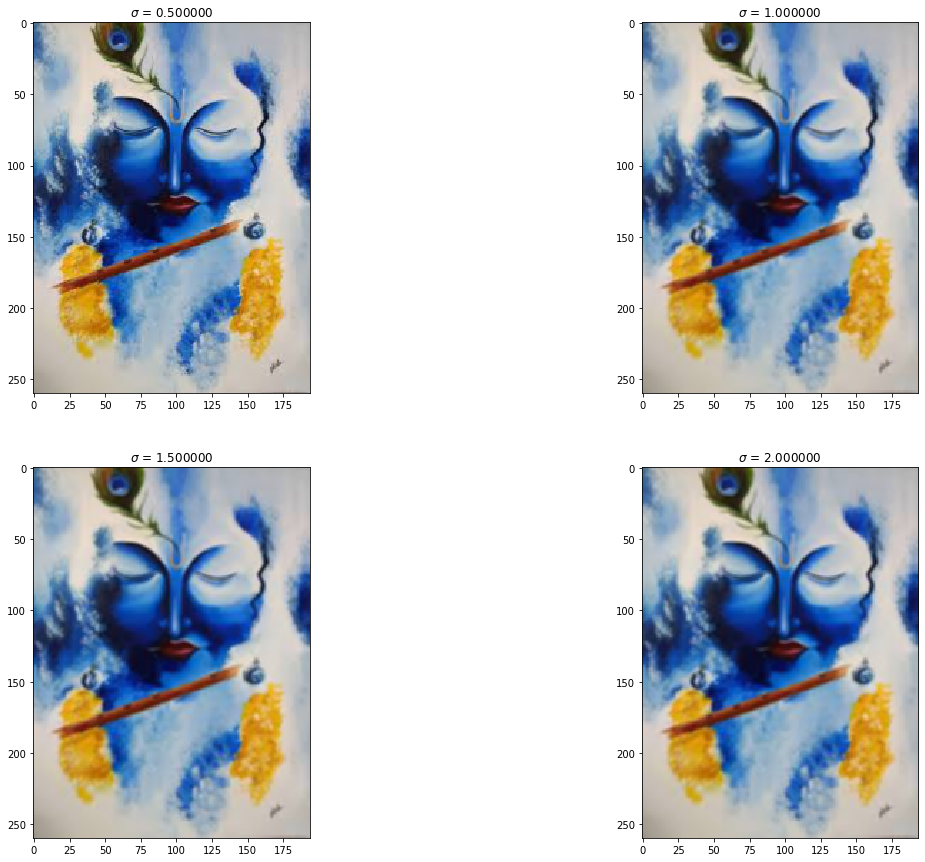

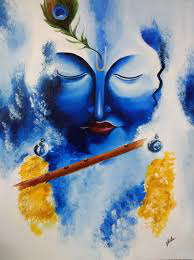

In [11]:
testing('testing.jpeg', 'stdout_max.txt')

(б). Из предыдущего пункта выяснили, что нужно менять и размер окна и сигму. Поэтому возьмем:

filter (15, 15), sigma = 4

In [12]:
img = Image.open('testing.jpeg')
rgbimg = img.convert('RGB')
r, c, _ = np.array(rgbimg).shape

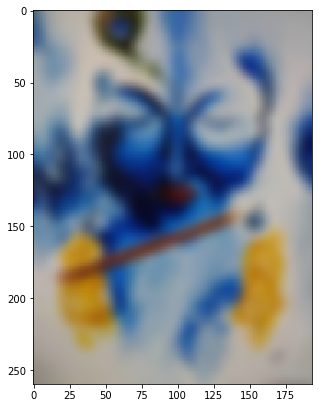

In [13]:
test_arr2 = np.array(open('case_out100.txt', 'r').read().replace('\n', ' ').split('R'))
test_arr2 = test_arr2[1:]
splitting = test_arr2[0].split('G')
R = splitting[0]
splitting = splitting[1].split('B')
G = splitting[0]
B = splitting[1]
R = np.asarray(R.replace('  ', ' ')[1:-2].split(' '), dtype=float)
G = np.asarray(G.replace('  ', ' ')[1:-2].split(' '), dtype=float)
B = np.asarray(B.replace('  ', ' ')[1:-2].split(' '), dtype=float)

A = []
A.append(R)
A.append(G)
A.append(B)
A = np.array(A, dtype=np.uint8)

A = np.transpose(A.reshape(3, -1)).reshape(r, c, 3)

img = Image.fromarray(A, 'RGB')

plt.figure(figsize=(5, 10))
plt.imshow(img)
plt.show()

    filter (3, 3), blocksize (16, 16)
    GPU : Elapsed time 0.21 ms

    filter (3, 3), blocksize (32, 32)
    GPU : Elapsed time 0.26 ms

    filter (3, 3)
    CPU : Elapsed time 3.80 ms


    filter (15, 15), blocksize (16, 16)
    GPU : Elapsed time 1.65 ms

    filter (15, 15), blocksize (32, 32)
    GPU : Elapsed time 1.48 ms

    filter (15, 15)
    CPU : Elapsed time 46.32 ms

## Тест 3. Большая картинка

In [14]:
img = Image.open('tree.jpg')
rgbimg = img.convert('RGB')
r, c, _ = np.array(rgbimg).shape

(a). Как обычно применим свертку с окном (3, 3). Сигма = 1, и 32 потока на блок.
Результаты размытия получатся незначительными.

In [ ]:
big_img('out2 (1).txt')

GPU: 1.31 ms

CPU : 39.63 ms


(b). Как уже было отмечено выше, результаты незначительны. Попробуем при таком же размере свертки поменять сигму, например на 4.

In [ ]:
big_img('out_big.txt')

Время такое же, как и в (а).

(с). Изменим, как и в Тесте 1, размер окна на (15, 15) и сигму = 4. Количество потоков на блок оставим тем же для чистоты эксперимента.

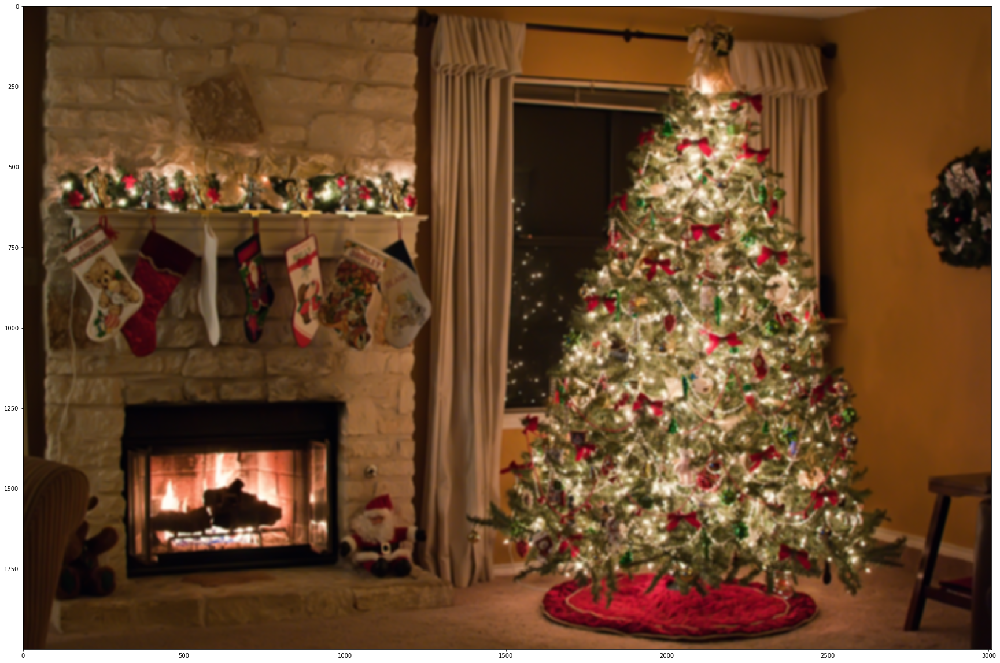

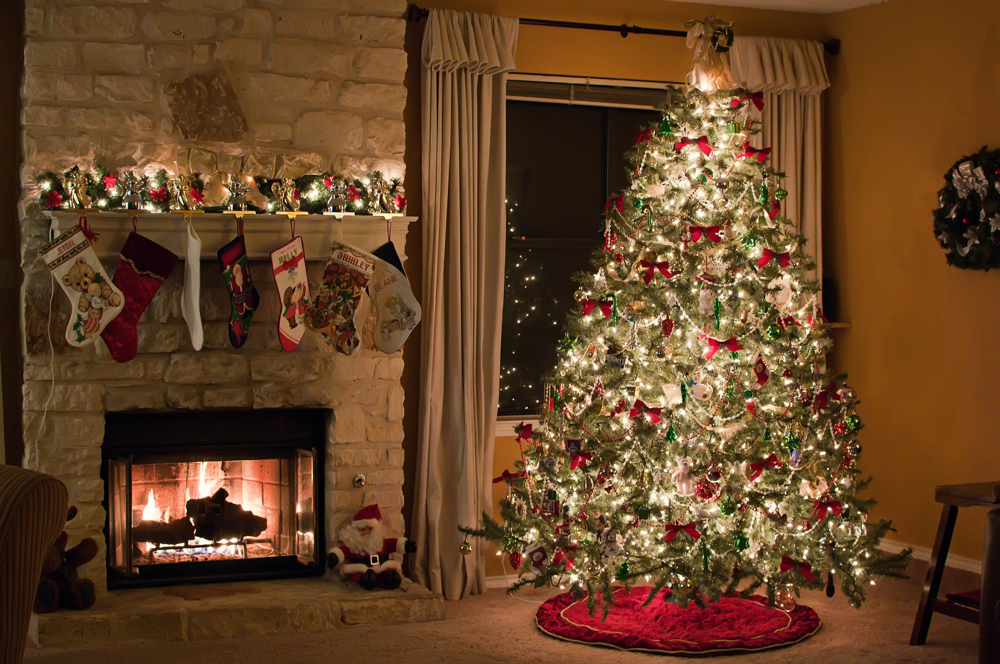

In [15]:
big_img('out_big2.txt')

In [ ]:
big_img('tree_25_4.txt')

    1. filter (15, 15) sigma = 4 , blocksize(32, 32)

        GPU : Elapsed time 121.26 ms

        CPU : Elapsed time 3764.59 ms


    2. filter (25, 25) sigma = 4
    
        GPU : Elapsed time 311.13 ms
        
        CPU : Elapsed time 8413.76 ms